In [10]:
import scipy.io
import argparse
import numpy as np
import h5py

def read_mat_file(file_path):
    """
    Reads a MATLAB (.mat) file and returns its contents as a dictionary.

    Parameters:
    file_path (str): Path to the MATLAB file.

    Returns:
    dict: Dictionary containing the contents of the MATLAB file.
    """
    try:
        mat_contents = scipy.io.loadmat(file_path, struct_as_record=False, squeeze_me=True)
        return mat_to_dict(mat_contents)
    except Exception as e:
        print(f"Error reading .mat file: {e}")
        return None

def mat_to_dict(mat_obj):
    """
    Recursively converts a MATLAB structure to a nested dictionary.

    Parameters:
    mat_obj: MATLAB object (dict, array, structure, etc.).

    Returns:
    dict: Nested dictionary representing the MATLAB object.
    """
    if isinstance(mat_obj, dict):
        return {key: mat_to_dict(value) for key, value in mat_obj.items() if not (key.startswith('__') and key.endswith('__'))}
    elif isinstance(mat_obj, np.ndarray):
        if mat_obj.size == 1:
            return mat_to_dict(mat_obj.item())
        else:
            return [mat_to_dict(element) for element in mat_obj]
    elif hasattr(mat_obj, '_fieldnames'):
        return {field: mat_to_dict(getattr(mat_obj, field)) for field in mat_obj._fieldnames}
    else:
        return mat_obj

def print_mat_structure(mat_obj, indent=0):
    """
    Recursively prints the structure of the MATLAB file contents.

    Parameters:
    mat_obj: MATLAB object (dict, array, structure, etc.).
    indent (int): The current level of indentation (for nested structures).
    """
    if isinstance(mat_obj, dict):
        for key, value in mat_obj.items():
            print(' ' * indent + f"{key}:")
            print_mat_structure(value, indent + 4)
    elif isinstance(mat_obj, np.ndarray):
        print(' ' * indent + f"Array, Shape: {mat_obj.shape}, Dtype: {mat_obj.dtype}")
    elif hasattr(mat_obj, '_fieldnames'):
        print(' ' * indent + "MATLAB Object")
        for field in mat_obj._fieldnames:
            print(' ' * (indent + 4) + f"{field}:")
            print_mat_structure(getattr(mat_obj, field), indent + 8)
    else:
        print(' ' * indent + f"Type: {type(mat_obj)}")

In [11]:
mat_dict = read_mat_file("data_gm0/M5p8_20130225162300_n0354_rmin0013_rmax0458km.mat")
files = h5py.File("data_gm0/japan_20130225162300.h5", 'r', locking=False)

In [12]:
vs30 = np.array(mat_dict['eq']['gan']['vs30'])
rhyp = np.array(mat_dict['eq']['gan']['rhyp'])
waveform = np.array(mat_dict['eq']['gan']['wfMat'])
idx = np.where((vs30 > 0) & (~np.isnan(vs30)) & (rhyp < 200))
vs30 = vs30[idx]
rhyp = rhyp[idx]
wf = waveform[idx]

In [18]:
file = open('data_gm0/japan_20130225162300.csv', 'w')
file.write('hypocentral_distance,is_shallow_crustal,magnitude,vs30,samples\n')
for i in range(len(vs30)):
    file.write(f"{rhyp[i]},{1},{5.8},{vs30[i]},1\n")
file.close()

In [14]:
print(files.keys())
rhyp_gm0 = files['hypocentral_distance']
vs30_gm0 = files['vs30']
st_tqdne = files['waveforms']

<KeysViewHDF5 ['hypocentral_distance', 'is_shallow_crustal', 'magnitude', 'vs30', 'waveforms']>


In [15]:
wf.shape, st_tqdne.shape

((226, 5501, 3), (22600, 3, 4064))

131.6463526784412 131.6463526784412
153.59783831827062 153.59783831827062
144.92540894522915 144.92540894522915
172.00495832502065 172.00495832502065
168.27740442711846 168.27740442711846
154.07363262766762 154.07363262766762
162.5225044794465 162.5225044794465
154.1198449971332 154.1198449971332
165.95019446913759 165.95019446913759
135.68964416485198 135.68964416485198
163.14716888123152 163.14716888123152
151.188373085757 151.188373085757
139.1181487115627 139.1181487115627
120.98762129763148 120.98762129763148
106.73839296344036 106.73839296344036
103.91871341960201 103.91871341960201
90.99368754799474 90.99368754799474
112.40498082231873 112.40498082231873
110.58011702265253 110.58011702265253
106.44485613134255 106.44485613134255
92.39588242896082 92.39588242896082


/tmp/ipykernel_10195/2558158828.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(number_figures+1, 3, figsize=(9, 5))


94.1889426059009 94.1889426059009
101.09641691594047 101.09641691594047
79.09672607910707 79.09672607910707
55.27213133300791 55.27213133300791
48.0961163168452 48.0961163168452
57.865979403940685 57.865979403940685
25.645177460779287 25.645177460779287
73.02673015617567 73.02673015617567
150.7952100638988 150.7952100638988
13.243138929331142 13.243138929331142
27.1149531737544 27.1149531737544
26.9715801978962 26.9715801978962
63.99410953277977 63.99410953277977
74.8962810219738 74.8962810219738
57.92401262740301 57.92401262740301
47.71787093640062 47.71787093640062
56.3459768458061 56.3459768458061
49.34008478592559 49.34008478592559
72.90491157670827 72.90491157670827
62.689976492296566 62.689976492296566
62.113115911346384 62.113115911346384
72.50101262518872 72.50101262518872
81.12487098340945 81.12487098340945
85.82139418986164 85.82139418986164
100.503487753156 100.503487753156
132.26833341825764 132.26833341825764
129.0341039320581 129.0341039320581
109.90699429456653 109.90699

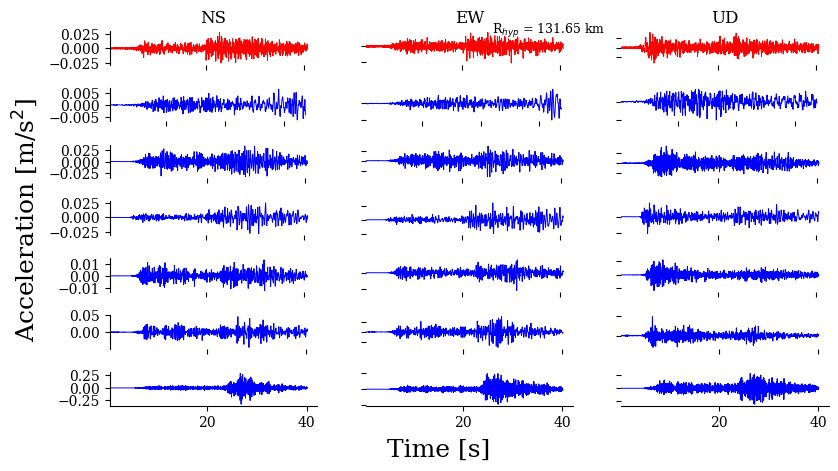

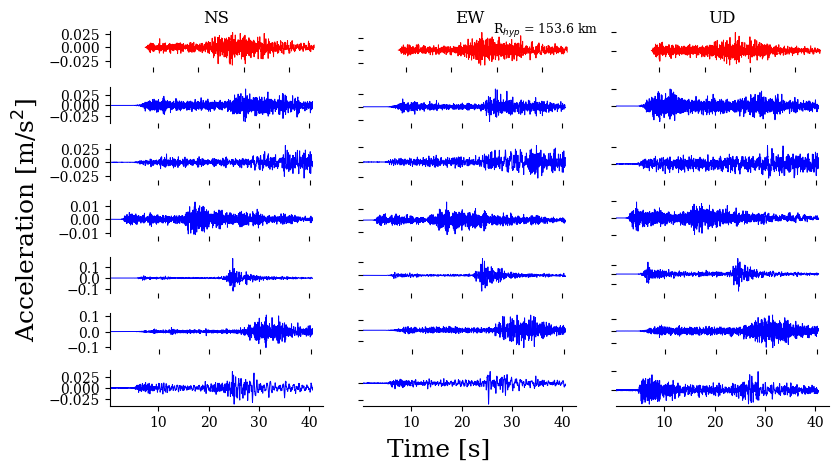

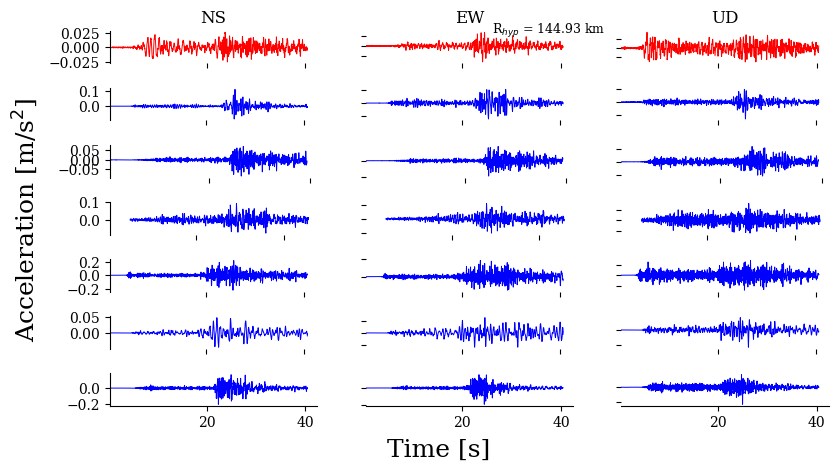

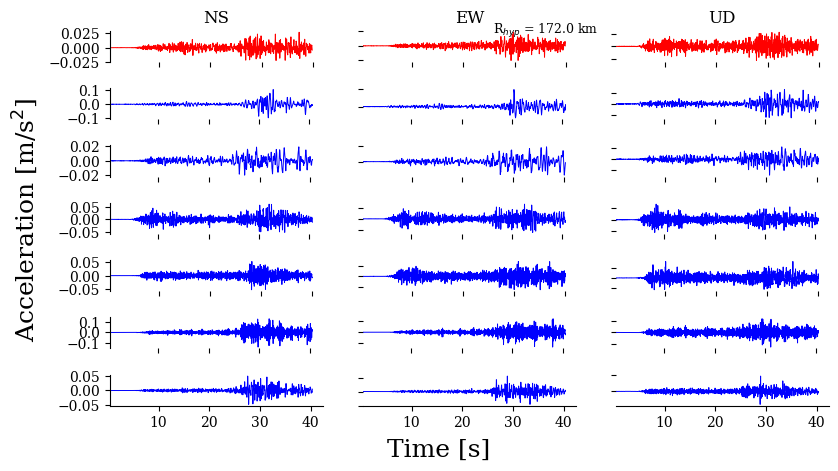

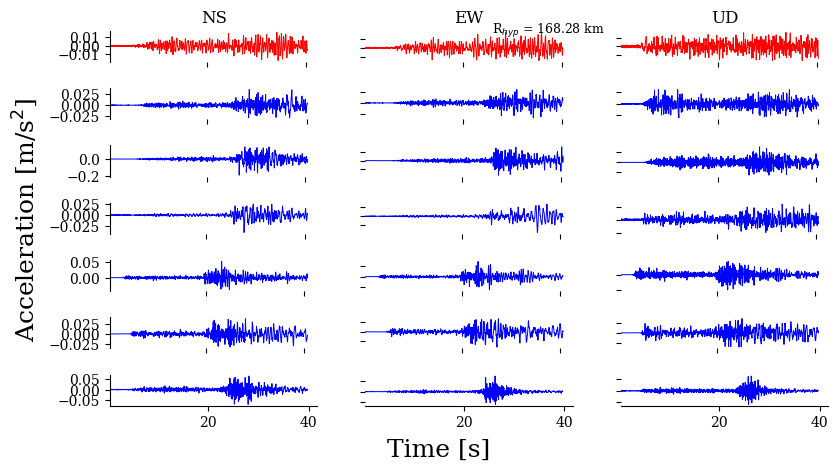

...

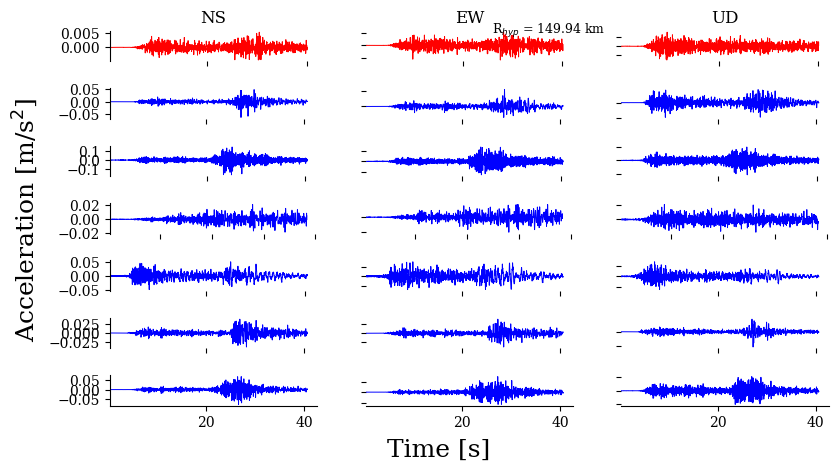

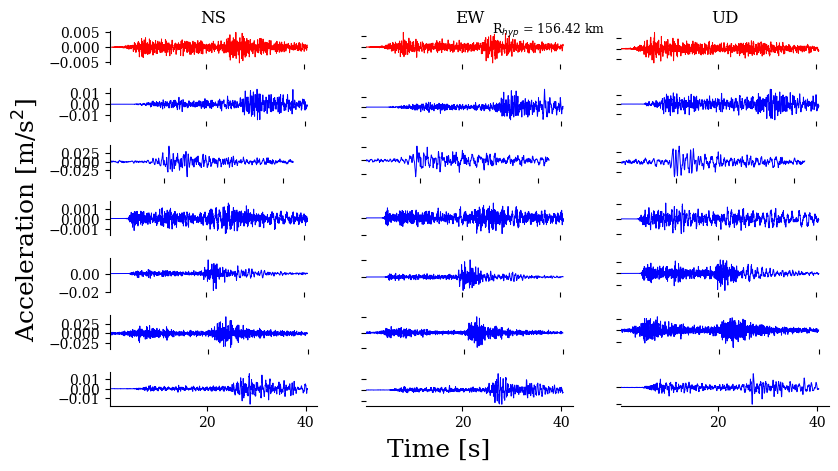

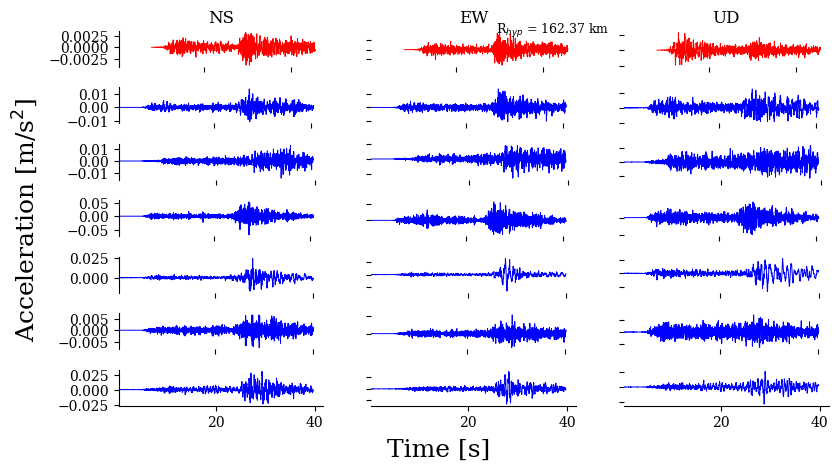

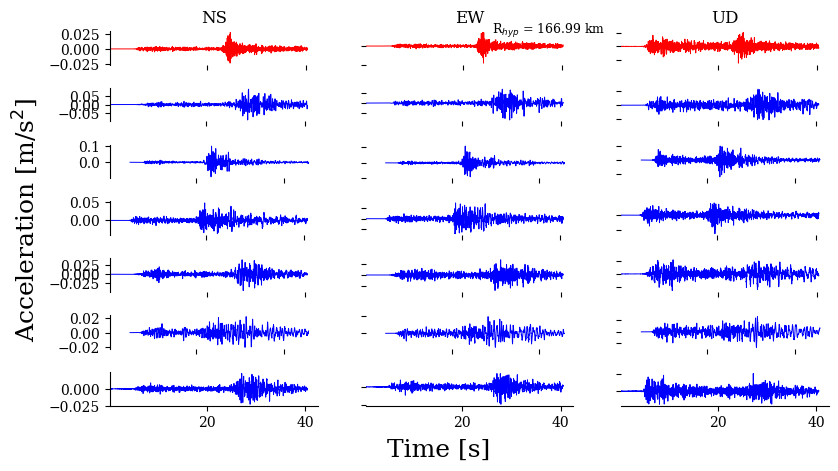

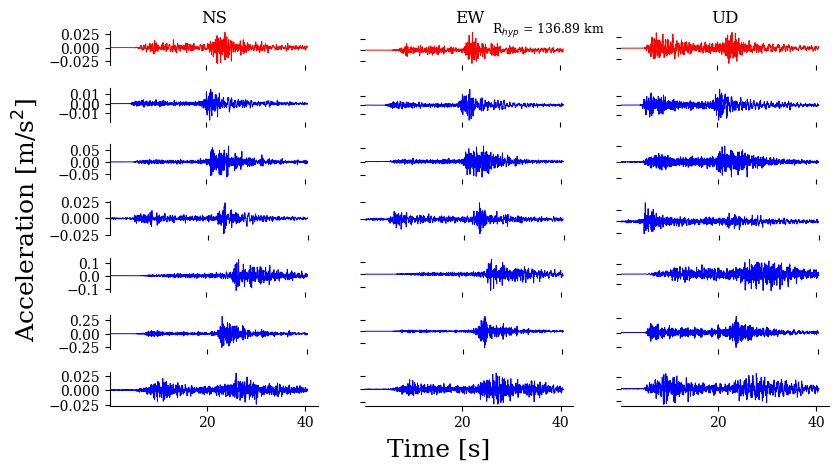

In [17]:
import matplotlib.pyplot as plt
from obspy.signal.trigger import recursive_sta_lta, trigger_onset
plt.rc('font', family='serif')
# plt.rcParams.update({'font.size': 12})

dt = 0.01
sampling_rate = 100
time1 = np.linspace(0, len(st_tqdne[0,0,:])*dt, len(st_tqdne[0,0,:]))
time = np.linspace(0, len(st_tqdne[0,0,:])*dt, len(st_tqdne[0,0,:]))
ind_obs = 7
for ind_obs in range(wf.shape[0]):
    nsample = 100
    print(rhyp[ind_obs], rhyp_gm0[nsample*ind_obs])

    number_figures = 6
    fig, axs = plt.subplots(number_figures+1, 3, figsize=(9, 5))
    # Set titles for the first row
    axs[0, 0].set_title("NS")
    axs[0, 1].set_title("EW")
    axs[0, 2].set_title("UD")

    # Plot data
    trigger_on = 2.0
    trigger_off = 1.0
    sta_lta_ratio = recursive_sta_lta(
                    wf[ind_obs, :, 2], 
                    int(2 * sampling_rate), 
                    int(5 * sampling_rate)
                )
    triggers = trigger_onset(sta_lta_ratio, trigger_on, trigger_off)
    onset = np.amin(triggers) if len(triggers) > 0 else 0
    time_onset = onset / sampling_rate
    
    linewidth = 0.7
    axs[0, 0].plot(time1-time_onset+5, wf[ind_obs, :len(st_tqdne[0,0,:]), 0], c='r', linewidth=linewidth)
    axs[0, 1].plot(time1-time_onset+5, wf[ind_obs, :len(st_tqdne[0,0,:]), 1], c='r', linewidth=linewidth)
    axs[0, 2].plot(time1-time_onset+5, wf[ind_obs, :len(st_tqdne[0,0,:]), 2], c='r', linewidth=linewidth)
    for i in range(number_figures):
        sta_lta_ratio = recursive_sta_lta(
                    st_tqdne[nsample*ind_obs + i, 2, :], 
                    int(2 * sampling_rate), 
                    int(5 * sampling_rate)
                )
        triggers = trigger_onset(sta_lta_ratio, trigger_on, trigger_off)
        onset = np.amin(triggers) if len(triggers) > 0 else 0
        time_onset = onset / sampling_rate
        
        axs[i+1, 0].plot(time-time_onset+5, st_tqdne[nsample*ind_obs + i, 0, :], c='b', linewidth=linewidth)
        axs[i+1, 1].plot(time-time_onset+5, st_tqdne[nsample*ind_obs + i, 1, :], c='b', linewidth=linewidth)
        axs[i+1, 2].plot(time-time_onset+5, st_tqdne[nsample*ind_obs + i, 2, :], c='b', linewidth=linewidth)

#     # Determine the maximum absolute y-value across all plots
#     max_y_value = 0
#     for i in range(number_figures+1):
#         for j in range(3):
#             max_y_value = max(max_y_value, np.abs(axs[i, j].get_ylim()).max())

#     # Set y-limits based on the maximum absolute value
#     for i in range(number_figures+1):
#         for j in range(3):
#             axs[i, j].set_ylim(-max_y_value, max_y_value)

#     # Set y-limits based on the maximum absolute value between each pair of rows
#     for i in range(number_figures+1):
#         row_max = max(np.abs(axs[i, 0].get_ylim()).max(), 
#                       np.abs(axs[i, 1].get_ylim()).max(), 
#                       np.abs(axs[i, 2].get_ylim()).max())
#         for j in range(3):
#             axs[i, j].set_ylim(-row_max, row_max)

    # Remove axis labels except for the last row and first column
    for i in range(number_figures+1):
        for j in range(3):
            if i != number_figures:
                axs[i, j].set_xticklabels([])
                axs[i, j].set_xlabel('')
            if j != 0:
                axs[i, j].set_yticklabels([])
                axs[i, j].set_ylabel('')

    # Remove figure frames except on the y-axis at the first column
    for i in range(number_figures+1):
        for j in range(3):
            if j != 0:
                axs[i, j].spines['left'].set_visible(False)
            if i != number_figures:
                axs[i, j].spines['bottom'].set_visible(False)
            axs[i, j].spines['top'].set_visible(False)
            axs[i, j].spines['right'].set_visible(False)
            axs[i, j].set_xlim(0.40)

    # it = 0
    # for i in range(0, number_figures, 2):
    #     axs[i, 1].text(-0.1, 1.01, f"{rhyp_gm0[nsample*ind_obs + i]} km", transform=axs[i, 1].transAxes, fontsize=9, va='center')
    #     axs[i+1, 1].text(-0.1, 1.01, f"{rhyp_gm0[nsample*ind_obs + i]} km", transform=axs[i+1, 1].transAxes, fontsize=9, va='center')
    #     it += 1
    axs[0, 1].text(0.61, 1.01, f"R$_{{hyp}}$ = {np.round(rhyp[ind_obs], decimals=2)} km", transform=axs[0, 1].transAxes, fontsize=9, va='center')

    # Add master labels
    fig.text(0.5, 0.04, 'Time [s]', ha='center', va='center', fontsize=18)
    fig.text(0.04, 0.5, 'Acceleration [m/s$^2$]', ha='center', va='center', rotation='vertical', fontsize=18)

    plt.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])
    fig.savefig(f"figures/waveforms/2013/generated_waveform_{ind_obs}.png", dpi=300, bbox_inches='tight')

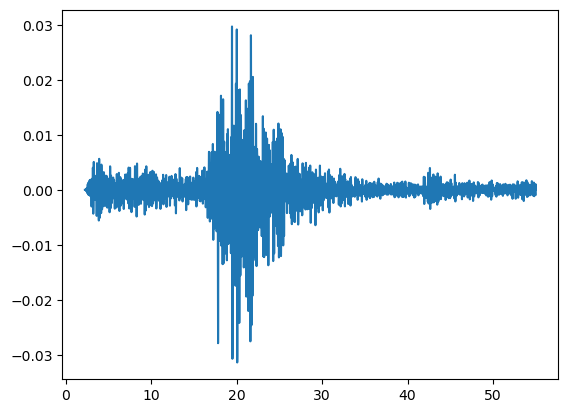

In [150]:
plt.plot(time1, wf[0,:,0])

In [152]:
ind_obs

0